# RARE ANIMALS IMAGE CLASSIFICATION - GROUP 12

#### **Group members**:
- **Yan Sidoryk** - 20222004
- **Henry Lewis** - 20222002
- **Abdul Rehman Khan** - 20231738
- **Lowie De Wever** - 20231733

## Importing libraries

In [ ]:
# Install all the packages
# !pip install -r requirements.txt

In [ ]:
# Standard library imports
import os
import math
from collections import Counter
import ast
import numpy as np
import pandas as pd
from tqdm import tqdm

# Visualization
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go

# Image processing
from PIL import Image as PilImage

# Machine learning
from sklearn.model_selection import train_test_split
from sklearn.metrics import f1_score, confusion_matrix, accuracy_score
from sklearn.utils.class_weight import compute_class_weight

# Deep learning 
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import Sequential ###, Model
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.regularizers import L1, L2
from tensorflow.keras.layers import Dense, Dropout, GlobalAveragePooling2D, BatchNormalization
from tensorflow.keras.optimizers import Adam, Adagrad
from tensorflow.keras.applications import InceptionV3, EfficientNetB4

# Hyperparameter tuning
import keras_tuner as kt

# Pretrained models (and torch)
from ultralytics import YOLO
from transformers import CLIPProcessor, CLIPModel
import torch

c:\Users\User\miniforge3\envs\dl\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
# Import custom functions
from custom_function import * 
%load_ext autoreload
%autoreload 2

In [3]:
directory = 'rare_species/'

In [4]:
# Cheak if GPU is detected
print(f"Cuda is availible: {torch.cuda.is_available()}")
print("GPUs detected:", tf.config.list_physical_devices('GPU'))

Cuda is availible: False
GPUs detected: [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [5]:
metadata = pd.read_csv(f'{directory}metadata.csv')

## Data exploration

### Metadata exploration

#### Basic exploration

In [6]:
metadata.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11983 entries, 0 to 11982
Data columns (total 7 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   rare_species_id  11983 non-null  object
 1   eol_content_id   11983 non-null  int64 
 2   eol_page_id      11983 non-null  int64 
 3   kingdom          11983 non-null  object
 4   phylum           11983 non-null  object
 5   family           11983 non-null  object
 6   file_path        11983 non-null  object
dtypes: int64(2), object(5)
memory usage: 655.4+ KB


In [7]:
metadata.head()

,rare_species_id,eol_content_id,eol_page_id,kingdom,phylum,family,file_path
0,75fd91cb-2881-41cd-88e6-de451e8b60e2,12853737,449393,animalia,mollusca,unionidae,mollusca_unionidae/12853737_449393_eol-full-si...
1,28c508bc-63ff-4e60-9c8f-1934367e1528,20969394,793083,animalia,chordata,geoemydidae,chordata_geoemydidae/20969394_793083_eol-full-...
2,00372441-588c-4af8-9665-29bee20822c0,28895411,319982,animalia,chordata,cryptobranchidae,chordata_cryptobranchidae/28895411_319982_eol-...
3,29cc6040-6af2-49ee-86ec-ab7d89793828,29658536,45510188,animalia,chordata,turdidae,chordata_turdidae/29658536_45510188_eol-full-s...
4,94004bff-3a33-4758-8125-bf72e6e57eab,21252576,7250886,animalia,chordata,indriidae,chordata_indriidae/21252576_7250886_eol-full-s...


In [8]:
metadata.describe(include='O')

,rare_species_id,kingdom,phylum,family,file_path
count,11983,11983,11983,11983,11983
unique,11983,1,5,202,11983
top,75fd91cb-2881-41cd-88e6-de451e8b60e2,animalia,chordata,cercopithecidae,mollusca_unionidae/12853737_449393_eol-full-si...
freq,1,11983,9952,300,1


In [9]:
plot_phylum_counts(metadata)

In [10]:
plot_family_counts(metadata)

In [24]:
plot_taxonomic_hierarchy(metadata)

#### Retracting more information from the images

In [25]:
# Extract more information about the images and save to the metadata
metadata['image_size'], metadata['color_channel'], metadata['format'], metadata['aspect_ratio'], \
metadata['min_val'], metadata['max_val'] = explore_image_files(directory + metadata['file_path'], explore_values=True)

# # Don't explore values to save time (1min)
# metadata['image_size'], metadata['color_channel'], metadata['format'], metadata['aspect_ratio'] = explore_image_files(directory + metadata['file_path'])

c:\Users\User\miniforge3\envs\dl\lib\site-packages\PIL\Image.py:3432: DecompressionBombWarning:

Image size (115600000 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.



In [26]:
# Compute width, height and pixel count
metadata['width'], metadata['height'] = zip(*metadata['image_size'])
metadata["pixel_count"] = metadata["width"] * metadata["height"]

In [27]:
metadata.head()

,rare_species_id,eol_content_id,eol_page_id,kingdom,phylum,family,file_path,image_size,color_channel,format,aspect_ratio,min_val,max_val,width,height,pixel_count
0,75fd91cb-2881-41cd-88e6-de451e8b60e2,12853737,449393,animalia,mollusca,unionidae,mollusca_unionidae/12853737_449393_eol-full-si...,"(400, 400)",RGB,JPEG,1.000000,0,255,400,400,160000
1,28c508bc-63ff-4e60-9c8f-1934367e1528,20969394,793083,animalia,chordata,geoemydidae,chordata_geoemydidae/20969394_793083_eol-full-...,"(1596, 1066)",RGB,JPEG,1.497186,0,255,1596,1066,1701336
2,00372441-588c-4af8-9665-29bee20822c0,28895411,319982,animalia,chordata,cryptobranchidae,chordata_cryptobranchidae/28895411_319982_eol-...,"(2480, 1396)",RGB,JPEG,1.776504,0,255,2480,1396,3462080
3,29cc6040-6af2-49ee-86ec-ab7d89793828,29658536,45510188,animalia,chordata,turdidae,chordata_turdidae/29658536_45510188_eol-full-s...,"(1554, 2019)",RGB,JPEG,0.769688,0,255,1554,2019,3137526
4,94004bff-3a33-4758-8125-bf72e6e57eab,21252576,7250886,animalia,chordata,indriidae,chordata_indriidae/21252576_7250886_eol-full-s...,"(1365, 2048)",RGB,JPEG,0.666504,0,255,1365,2048,2795520


In [28]:
metadata.describe()

,eol_content_id,eol_page_id,aspect_ratio,min_val,max_val,width,height,pixel_count
count,1.198300e+04,1.198300e+04,11983.000000,11983.000000,11983.000000,11983.000000,11983.000000,1.198300e+04
mean,2.297681e+07,2.112247e+07,1.332127,1.096553,253.275807,1924.600935,1512.260285,3.948089e+06
std,6.999289e+06,2.241319e+07,0.396398,5.838642,8.035275,1267.575315,951.330175,5.535964e+06
min,4.750000e+02,1.180080e+05,0.199919,0.000000,124.000000,170.000000,125.000000,2.489700e+04
25%,2.058937e+07,7.954560e+05,1.247341,0.000000,255.000000,1000.000000,768.000000,7.530000e+05
50%,2.251368e+07,2.865857e+06,1.333333,0.000000,255.000000,1784.000000,1365.000000,2.764800e+06
75%,2.932887e+07,4.551773e+07,1.500366,0.000000,255.000000,2048.000000,2013.500000,3.236208e+06
max,3.061946e+07,5.269200e+07,7.534247,137.000000,255.000000,17000.000000,8688.000000,1.156000e+08


c:\Users\User\miniforge3\envs\dl\lib\site-packages\PIL\Image.py:3432: DecompressionBombWarning:

Image size (115600000 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.



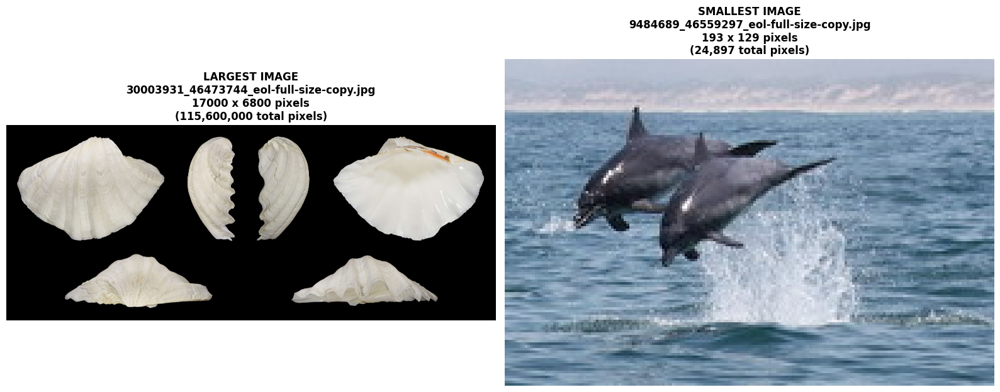

Largest image path:  rare_species/mollusca_cardiidae/30003931_46473744_eol-full-size-copy.jpg

Smallest image path: rare_species/chordata_delphinidae/9484689_46559297_eol-full-size-copy.jpg


In [29]:
smallest_largest_image(metadata, directory)

In [30]:
# Based on previous discoveries set up potencial boudaries for image scaling
common_ratio = 4/3
width_max = 500       

In [35]:
plot_image_size_scatter(metadata, common_ratio, width_max)

In [32]:
# Calculate the final image size
image_size = (width_max, round(width_max/common_ratio))
print(f"Best image size to scale to is {image_size}")

Best image size to scale to is (500, 375)


In [34]:
plot_color_chanels_counts(metadata)

### Images exploration

#### All images

In [ ]:
# Running this cell produces too many images and makes the notebook 6 times the size
# So we will avoid running it in the final submission, but it was used for data exploration
# plot_images_from_directory(directory, img_per_class=5) 

From plotting sample of the images we can see that have some unusial examples like:

- X-ray imagaes
- Images of signs
- Paintings
- Text extracts with no images
- Images unrelated to the class
- Maps
- Varying zoom / color / rotations

#### Grayscale and CMYK
Lets take a look at what are the different color formats

In [36]:
datagen = ImageDataGenerator(rescale=1./255)

# Get only greyscale images
temp_generator = datagen.flow_from_dataframe(
    dataframe=metadata[metadata.color_channel == 'L'],
    directory=directory,
    x_col='file_path',
    y_col='family',
    target_size=image_size,
    batch_size=32,
    class_mode='categorical',
    shuffle=False   # Not shuffling
)

Found 183 validated image filenames belonging to 62 classes.


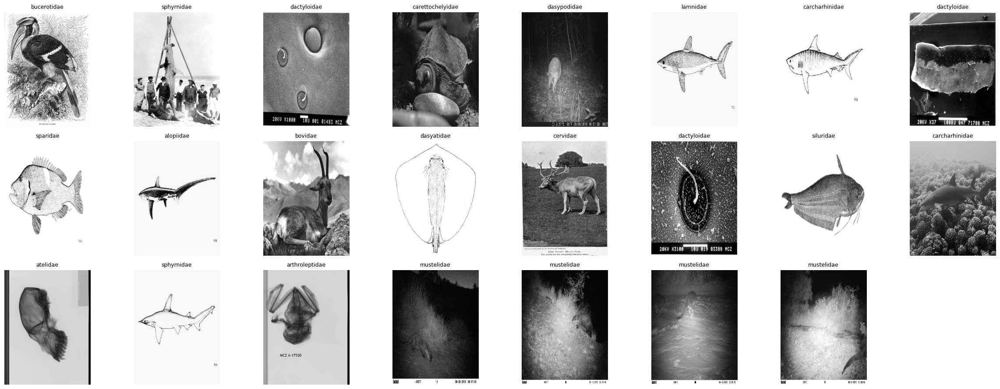

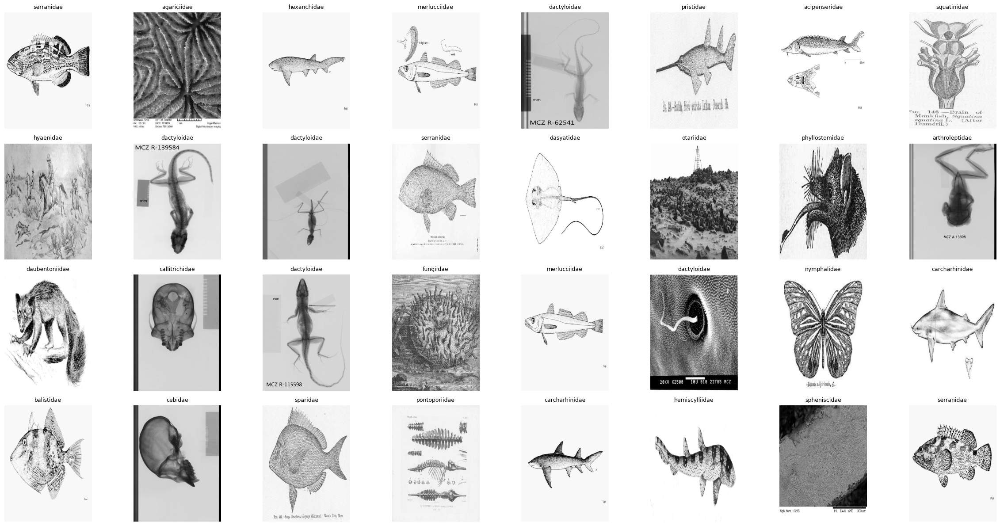

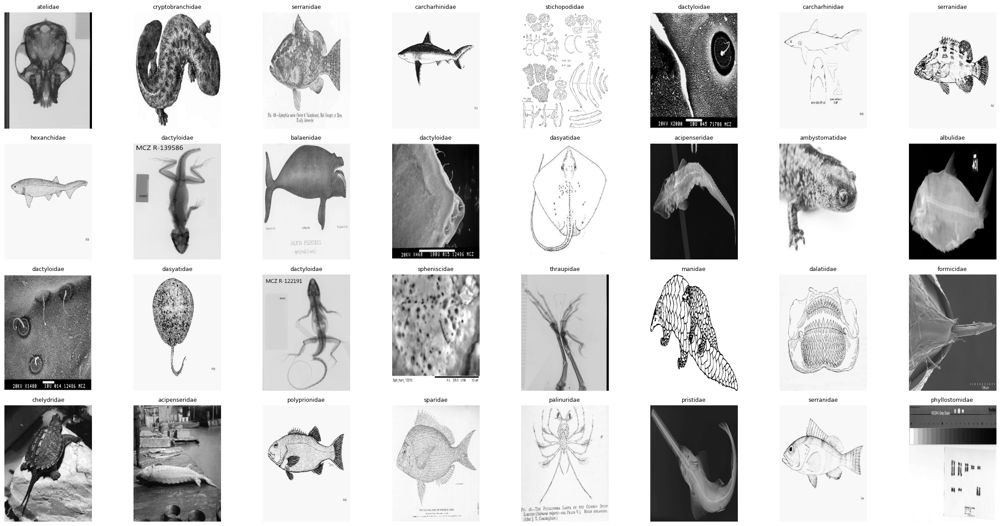

In [38]:
plot_images_from_generator(temp_generator, num_batches=3)

We can see that most of Grayscale images are sketches, drawings, X-rays or just old photos. Some images retain at least the shape of the actual animal, but most of them are really bad.

In [39]:
# Do the same for CMYK
temp_generator = datagen.flow_from_dataframe(
    dataframe=metadata[metadata.color_channel == 'CMYK'],
    directory=directory,
    x_col='file_path',
    y_col='family',
    target_size=image_size,
    batch_size=32,
    class_mode='categorical',
    shuffle=False   # Not shuffling
)

Found 178 validated image filenames belonging to 8 classes.


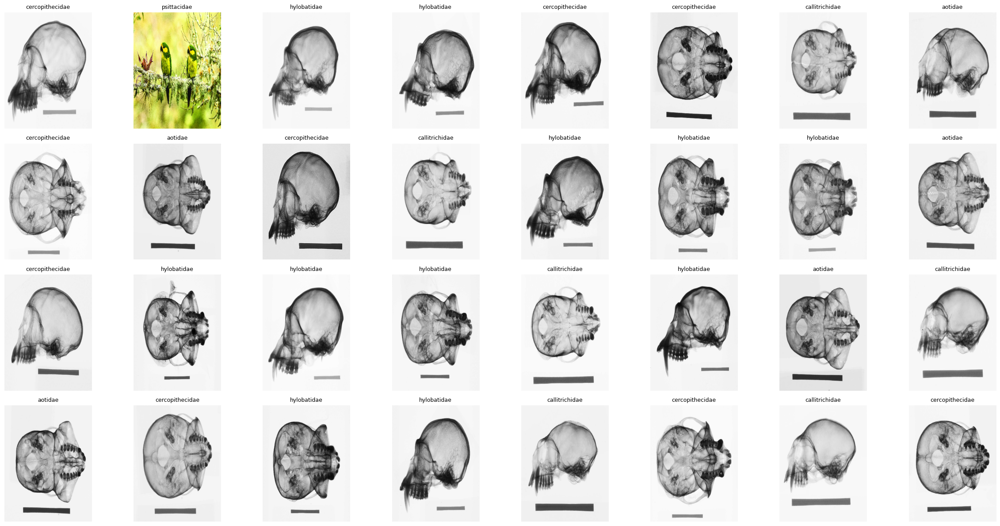

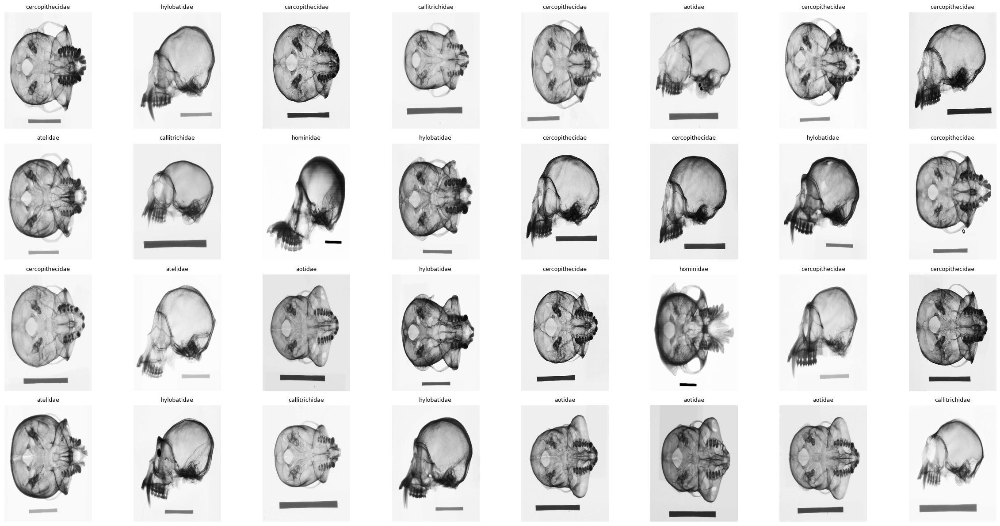

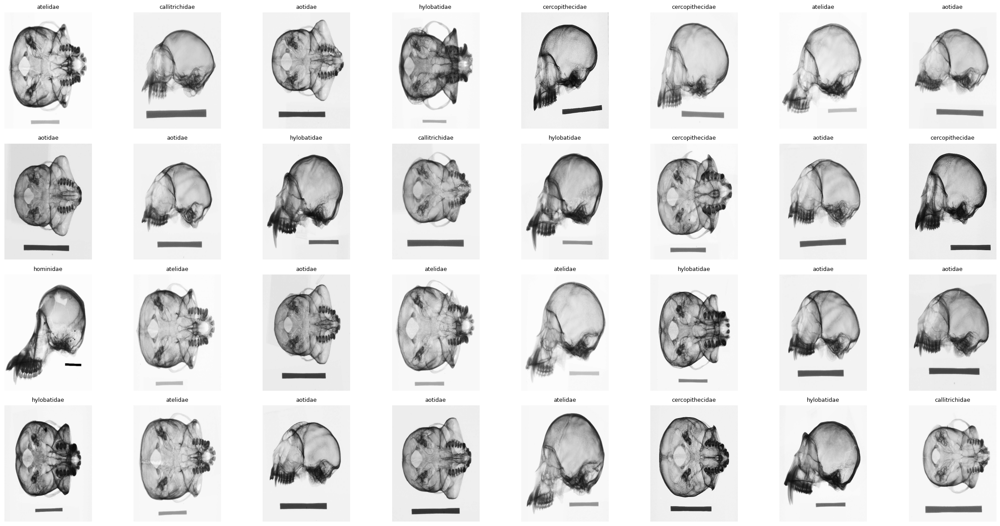

In [40]:
plot_images_from_generator(temp_generator, num_batches=3)

Most of the images apper to be x-rays of sculls of different types of monkeys and apes, which don't really help identify the animals by the picture, and will more likely only confuse the model. \
(and there are 2 different images for some reason: 1 with 2 parrots and another with a turtle)

In [41]:
# See what is the class distribution amoung the greyscale images
unique, counts = np.unique(temp_generator.classes, return_counts=True)
counts_per_class = dict(zip(unique, counts))

idx_to_class = {v: k for k, v in temp_generator.class_indices.items()}

for idx, count in counts_per_class.items():
    print(f"{idx_to_class[idx]}: {count} images")

aotidae: 36 images
atelidae: 27 images
callitrichidae: 30 images
cercopithecidae: 42 images
emydidae: 1 images
hominidae: 4 images
hylobatidae: 37 images
psittacidae: 1 images


In [42]:
# Changing good CMYK images to RGB in the metadata to keep them in the dataset
metadata.loc[metadata['family'].isin(['chordata_emydidae', 'chordata_psittacidae']) & 
             (metadata['color_channel'] == 'CMYK'), 'color_channel'] = 'RGB'

## Preprocessing

### Remove CMYK and Grayscale

In [43]:
# Remove CMYK and Grayscale images from metadata (keeping the 2 good CMYK images)
print(f"Original metadata size: {len(metadata)}")
metadata = metadata[~metadata['color_channel'].isin(['CMYK', 'L'])].reset_index(drop=True)
print(f"After removing CMYK/grayscale: {len(metadata)}")

Original metadata size: 11983
After removing CMYK/grayscale: 11622


### Outlier detection

#### YOLO

In [46]:
# Set up the parameters for the model
MODEL_ID = 'yolov8s.pt'
CONFIDENCE_THRESHOLD = 0.85
PERSON_CLASS_ID = 0

In [47]:
# Run YOLO person detection
metadata['has_person'], metadata['person_confidence'], metadata['person_bbox'] = find_people_yolo(metadata, directory, MODEL_ID, CONFIDENCE_THRESHOLD, PERSON_CLASS_ID)

# Print the results
print(f"\n--- YOLO Results ---")
print(f"Images with people: {metadata['has_person'].sum()}")
print(f"Images without people: {(~metadata['has_person']).sum()}")

Scanning for people with confidence > 0.85.


YOLO person detection: 100%|██████████| 11622/11622 [15:01<00:00, 12.89it/s]


--- YOLO Results ---
Images with people: 184
Images without people: 11438


#### Imagenet detection

In [48]:
# Load the model
imagenet_model = InceptionV3(weights='imagenet')

In [49]:
# Run animal detection with pretrained model
metadata['has_animal'], metadata['animal_confidence'], metadata['predicted_class'], metadata['prediction_confidence'] = check_animal_presence(metadata, directory, imagenet_model)

# Print the results
print(f"\n--- ImageNet Results : ---")
print(f"Images with animals: {metadata['has_animal'].sum()}")
print(f"Images without animals: {(~metadata['has_animal']).sum()}")

ImageNet animal detection:  85%|████████▌ | 9897/11622 [13:39<02:15, 12.77it/s]c:\Users\User\miniforge3\envs\dl\lib\site-packages\PIL\Image.py:3432: DecompressionBombWarning:

Image size (115600000 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.

ImageNet animal detection: 100%|██████████| 11622/11622 [16:00<00:00, 12.10it/s]



--- ImageNet Results : ---
Images with animals: 6947
Images without animals: 4675


#### Clip

In [50]:
# Load CLIP model
clip_model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")
clip_processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")

# Define semantic categories
text_prompts = [
    # Good categories (KEEP) - indices 0-2
    "a photograph of an animal",
    "a wildlife photograph",
    "a photo of an animal in nature",
    
    # Bad categories (REMOVE) - indices 3+
    "an x-ray image",
    "a medical scan",
    "a drawing or sketch",
    "a map or diagram",
    "text document or book page",
    "a logo or icon",
    "a cooked meal",
    "prepared food",
    "a human",
    "a photo of a person",
    "a portrait of a human face",
    "people in a photograph",
    "a group of people",
    "a scientist or researcher",
]

# Compute text embeddings
text_inputs = clip_processor(text=text_prompts, return_tensors="pt", padding=True)
with torch.no_grad():
    text_features = clip_model.get_text_features(**text_inputs)
    text_features = text_features / text_features.norm(dim=-1, keepdim=True)

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


In [51]:
# Run CLIP scoring on metadata
clip_results = compute_clip_scores_batch(metadata, directory, clip_processor, clip_model, text_prompts, text_features, batch_size=32)

# Add CLIP columns to metadata
metadata['clip_photo_score'] = clip_results['clip_photo_score']
metadata['clip_noise_score'] = clip_results['clip_noise_score']
metadata['clip_semantic_quality'] = clip_results['clip_semantic_quality']
metadata['clip_best_match'] = clip_results['clip_best_match']

Computing CLIP scores:  85%|████████▍ | 309/364 [10:02<01:52,  2.04s/it]c:\Users\User\miniforge3\envs\dl\lib\site-packages\PIL\Image.py:3432: DecompressionBombWarning:

Image size (115600000 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.

Computing CLIP scores: 100%|██████████| 364/364 [11:44<00:00,  1.93s/it]


#### Visualization / Comparisons

Showing 100 images with people detected by YOLO



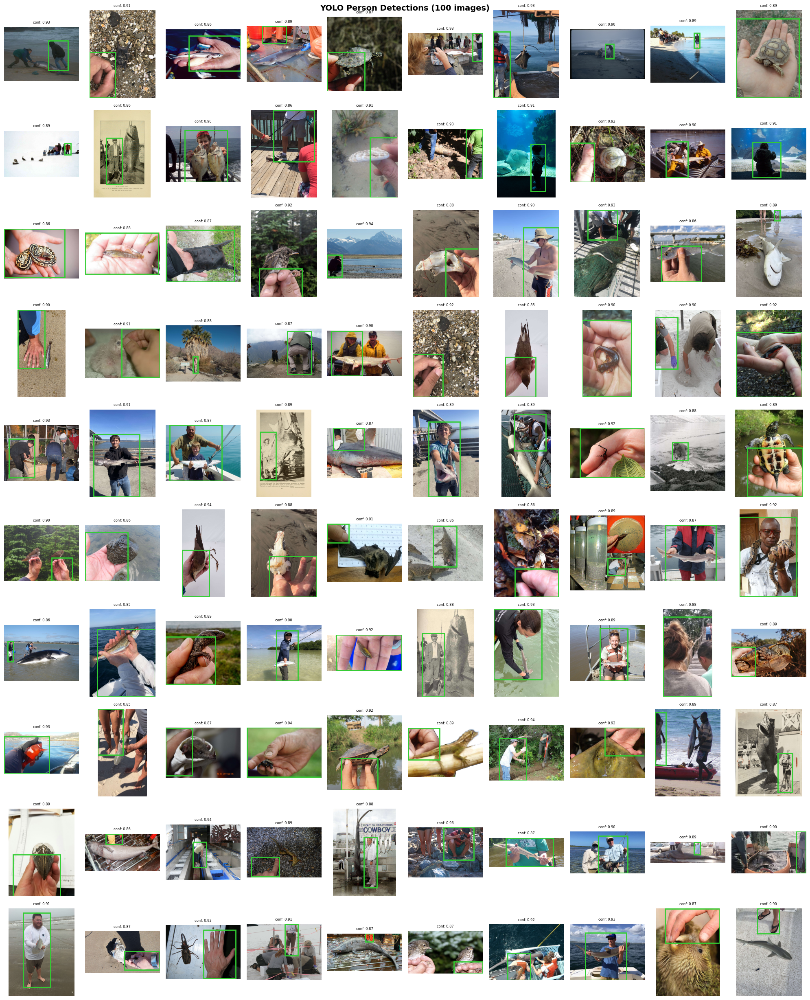

In [52]:
plot_yolo_detections(metadata, directory, 100)

Showing 50 of 4675 non-animal images detected by InceptionV3



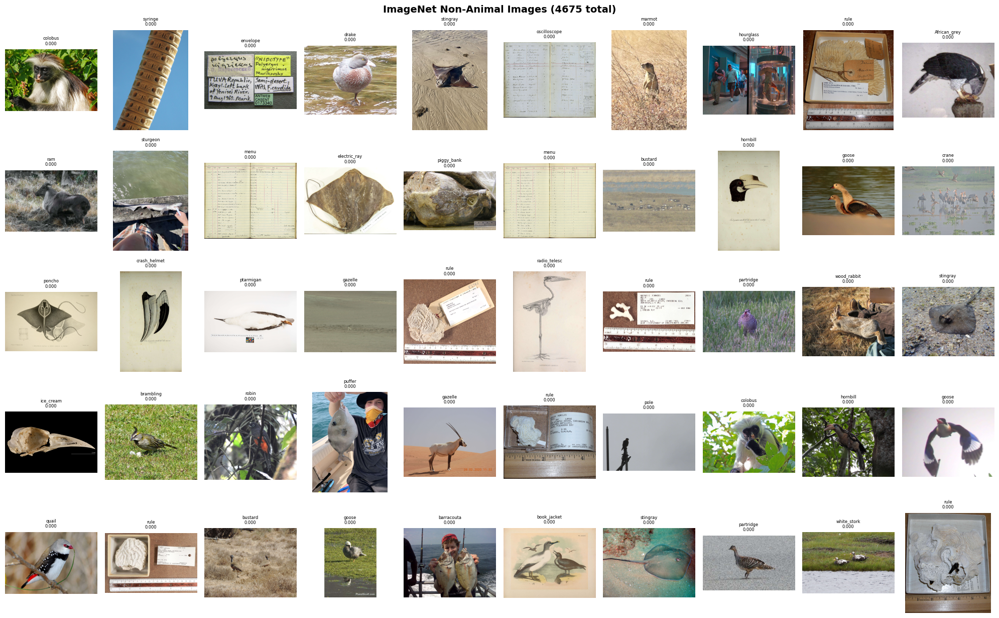

In [53]:
plot_non_animal_images(metadata, directory, n_cols=10)

CLIP Category breakdown (total 640):
clip_best_match
an x-ray image                163
text document or book page     80
a scientist or researcher      75
a group of people              56
a portrait of a human face     55
a map or diagram               48
a human                        39
a medical scan                 32
a photo of a person            29
people in a photograph         23
prepared food                  22
a cooked meal                   9
a logo or icon                  5
a drawing or sketch             4
Name: count, dtype: int64


Showing 100 CLIP outliers



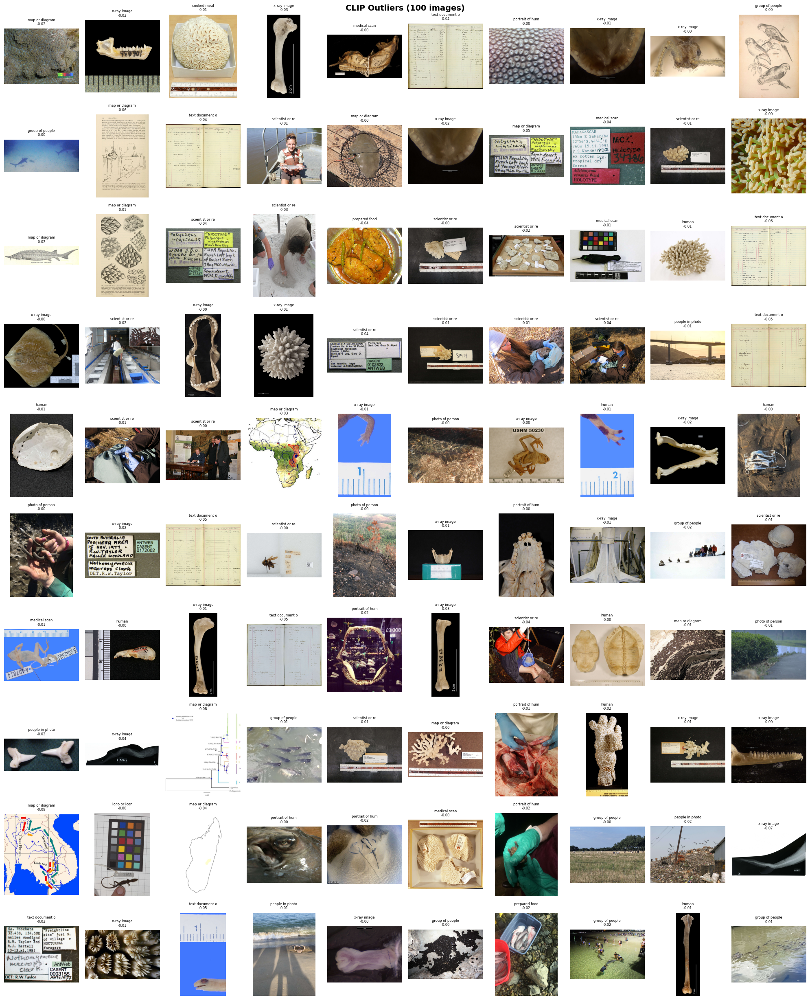

In [54]:
plot_clip_outliers(metadata, directory, 100)

Short visualization summary:
- YOLOv8 person detection incorrectly flagged too many images of researchers holding animals, which we would like to keep.
- InceptionV3 flagged almost 40% of the images as "not containing animals", with a lot of misclassifications.
- CLIP gave the best results, identifying 640 outliers such as X-rays, diagrams, and text.

### Outlier removal

In [55]:
# Remove the outliers based on the CLIP results
clip_outliers = metadata[metadata['clip_semantic_quality'] < 0].copy()
metadata = metadata[metadata['clip_semantic_quality'] >= 0].reset_index(drop=True)

In [56]:
# Check what class has the least images (save the family name for later)
low_images_class = metadata['family'].value_counts().idxmin()
print(f"Total images after removing inconsistencies: {len(metadata)} out of {len(metadata) + len(clip_outliers)} ({len(clip_outliers)} removed)")
print(f"The lowest amount of images per class is '{low_images_class}' with {metadata['family'].value_counts().iloc[-1]} images")

Total images after removing inconsistencies: 10982 out of 11622 (640 removed)
The lowest amount of images per class is 'brachypteraciidae' with 16 images


### Generate embeddings

In [57]:
# Load pre-trained EfficientNet without the top classification layer
embedding_model = EfficientNetB4(weights='imagenet', include_top=False, pooling='avg')
print(f"Embedding dimension: {embedding_model.output_shape[-1]}")

Embedding dimension: 1792


In [58]:
# Add embedings to metadata
metadata['embedding'] = generate_embeddings(metadata, directory, image_size, embedding_model)

Found 10982 validated image filenames belonging to 202 classes.


Embedding images: 100%|██████████| 344/344 [03:48<00:00,  1.50it/s]


### Remove inconsistencies

In [59]:
# Split the metadata not to leak the test embeddings
train_df, test_df = train_test_split(
  metadata,
  test_size=0.15,                 
  stratify=metadata['family'],    # Stratify by the target
  shuffle=True,
  random_state=42
)

In [60]:
# Calculate distance to centroids (centroids are based only on train embeddings)
train_df['distance_to_centroid'], test_df['distance_to_centroid'] = distance_to_centroid(train_df, test_df)

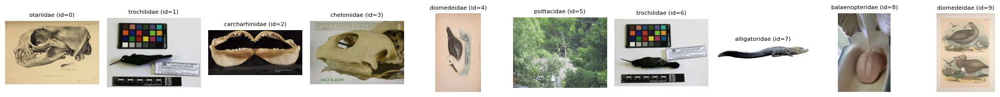

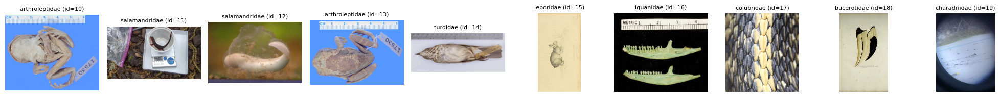

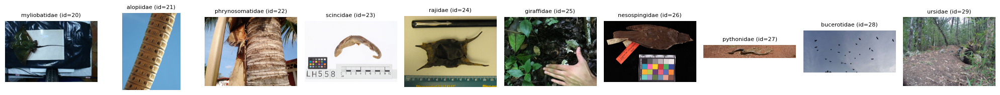

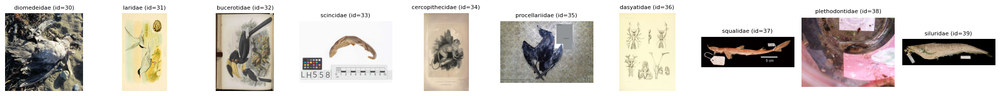

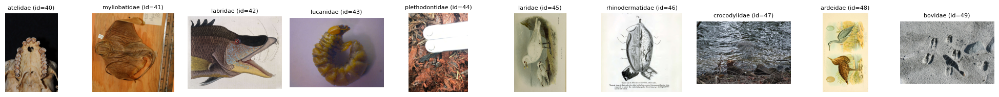

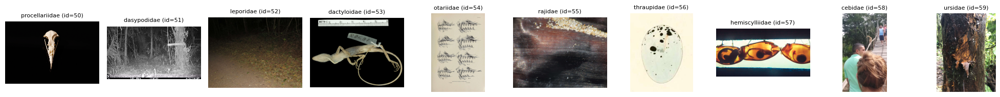

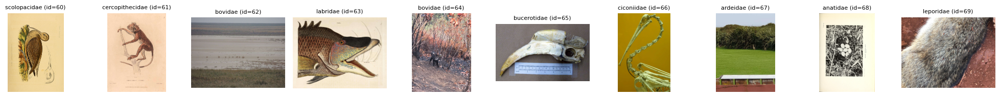

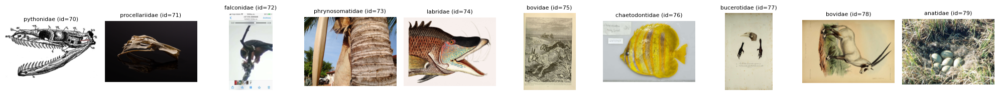

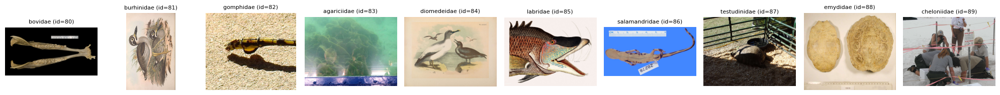

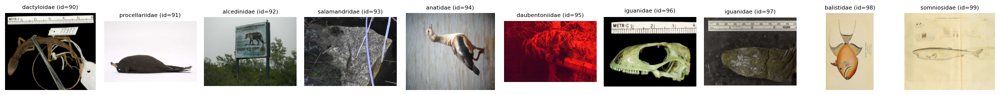

In [61]:
plot_furthest_images_batched(directory, train_df, 100)

In [62]:
# Identify outliers based on distance to the centroid
threshold = train_df['distance_to_centroid'].quantile(0.95) 

# Copy outliers in case we need them later
outliers_train = train_df[train_df['distance_to_centroid'] > threshold].copy()
outliers_test = test_df[test_df['distance_to_centroid'] > threshold].copy()     

# Remove outliers from the main dataset
train_df = train_df[train_df['distance_to_centroid'] <= threshold].copy()
test_df = test_df[test_df['distance_to_centroid'] <= threshold].copy()

print(f"Removed {len(outliers_train)} outliers from train data")
print(f"Removed {len(outliers_test)} outliers from test data")

Removed 467 outliers from train data
Removed 111 outliers from test data


In [63]:
# See what class has the least images (save the family name for later)
low_images_class = train_df['family'].value_counts().idxmin()
print(f"Total images after removing inconsistencies: {len(train_df) + len(test_df)} (out of {len(metadata)})")
print(f"Images left for training: {len(train_df)}. Images left for testing: {len(test_df)}.")
print(f"The lowest amount of images per class is '{low_images_class}' with {train_df['family'].value_counts().iloc[-1]} images for training and {test_df['family'].value_counts().iloc[-1]} images for testing")

Total images after removing inconsistencies: 10404 (out of 10982)
Images left for training: 8867. Images left for testing: 1537.
The lowest amount of images per class is 'brachypteraciidae' with 13 images for training and 2 images for testing


In [64]:
# Recalculate centroids
train_df.drop('distance_to_centroid', axis=1, inplace=True)
test_df.drop('distance_to_centroid', axis=1, inplace=True)
train_df['distance_to_centroid'], test_df['distance_to_centroid'] = distance_to_centroid(train_df, test_df)

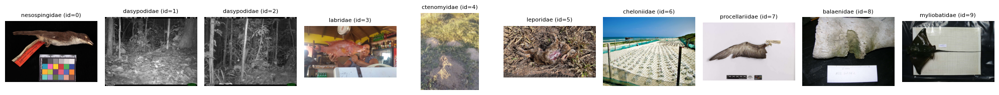

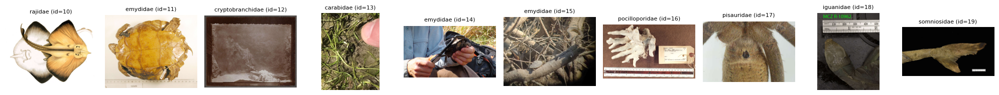

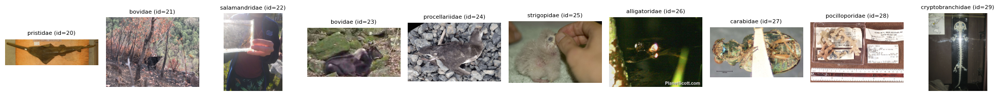

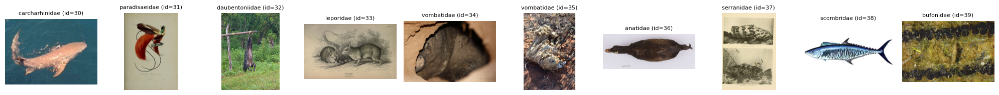

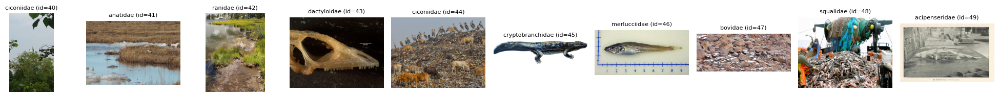

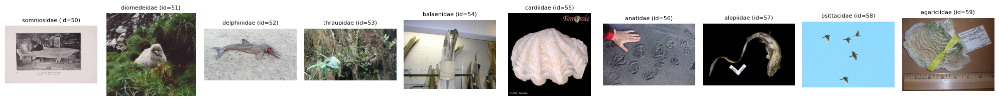

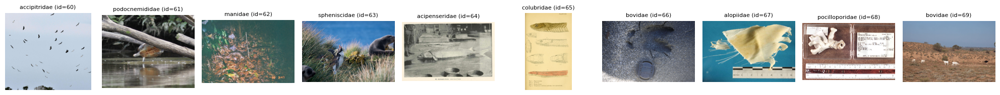

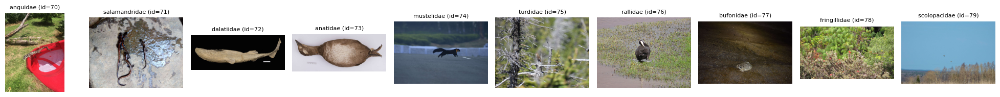

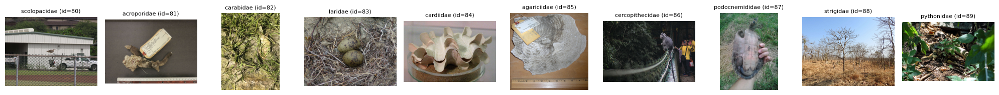

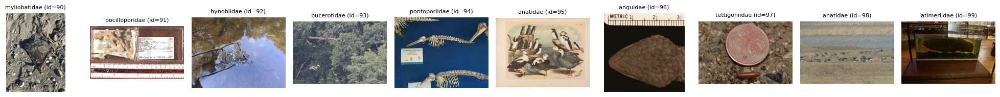

In [65]:
plot_furthest_images_batched(directory, train_df, 100)

In [66]:
# Identify outliers based on distance to centroid (higher threshold this time)
threshold = train_df['distance_to_centroid'].quantile(0.975) 

# Copy outliers in case we need them later
outliers_train = pd.concat([outliers_train, train_df[train_df['distance_to_centroid'] > threshold]], ignore_index=True)
outliers_test = pd.concat([outliers_test, test_df[test_df['distance_to_centroid'] > threshold]], ignore_index=True)   

# Remove outliers from the main dataset
train_df = train_df[train_df['distance_to_centroid'] <= threshold].copy()
test_df = test_df[test_df['distance_to_centroid'] <= threshold].copy()

print(f"Removed Total of {len(outliers_train)} outliers from train data")
print(f"Removed Total of {len(outliers_test)} outliers from test data")

Removed Total of 689 outliers from train data
Removed Total of 153 outliers from test data


In [67]:
# See what class has the least images (save the family name for later)
low_images_class = train_df['family'].value_counts().idxmin()
print(f"Total images after removing inconsistencies: {len(train_df) + len(test_df)} (out of {len(metadata)})")
print(f"Images left for training: {len(train_df)}. Images left for testing: {len(test_df)}.")
print(f"The lowest amount of images per class is '{low_images_class}' with {train_df['family'].value_counts().iloc[-1]} images for training and {test_df['family'].value_counts().iloc[-1]} images for testing")

Total images after removing inconsistencies: 10140 (out of 10982)
Images left for training: 8645. Images left for testing: 1495.
The lowest amount of images per class is 'brachypteraciidae' with 13 images for training and 1 images for testing


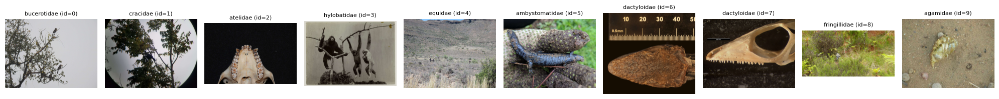

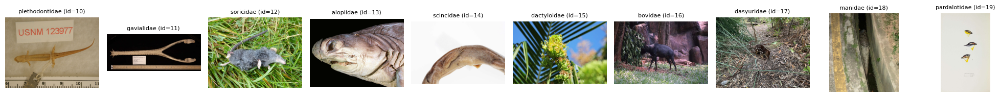

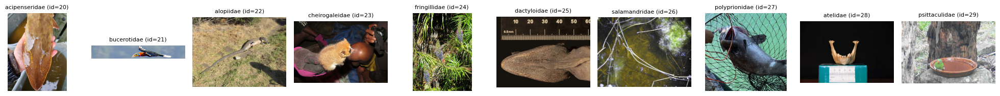

In [71]:
plot_furthest_images_batched(directory, train_df, 30)

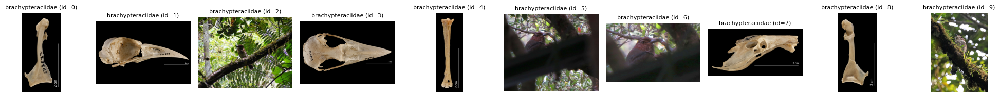

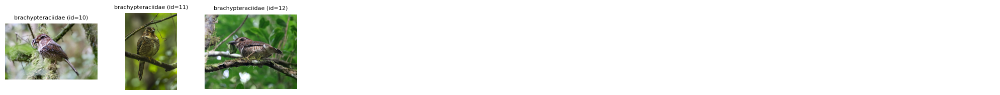

In [72]:
plot_furthest_images_batched(directory, train_df[train_df.family == low_images_class], 20)

### Split the data

In [73]:
# Set a part of train for validation
train_df, val_df = train_test_split(
  train_df,
  test_size=0.1,
  stratify=train_df['family'],
  shuffle=True,
  random_state=42
)

# Print the final proportions of the split
total_data_len = len(train_df) + len(val_df) + len(test_df)     # Amout of data after cleaning
print(f"Training  : {len(train_df)} ({round(len(train_df)/total_data_len*100)}%) \
        \nValidation: {len(val_df)} ({round(len(val_df)/total_data_len*100)}%)  \
        \nTesting   : {len(test_df)} ({round(len(test_df)/total_data_len*100)}%) \
        \nTotal     : {total_data_len}")

Training  : 7780 (77%)         
Validation: 865 (9%)          
Testing   : 1495 (15%)         
Total     : 10140


In [74]:
# Set up train generator with data augmentatin
train_datagen = ImageDataGenerator(
    horizontal_flip=True,
    rotation_range=15,
    zoom_range=0.1,
    fill_mode='nearest',
    # width_shift_range=0.10,
    # height_shift_range=0.10,
)

# Validation/Test generator (no augmentation)
test_datagen = ImageDataGenerator()

In [75]:
# Create train from train_datagen
train_generator = train_datagen.flow_from_dataframe(
    dataframe=train_df,
    directory=directory,
    x_col='file_path',
    y_col='family',
    target_size=image_size,     # Transform to image_size
    batch_size=32,
    class_mode='sparse',        # Use sparse for integer labels
    color_mode='rgb',           # Convert all the images to RGB
    shuffle=True,               # Shuffle the train set
    seed=42
)

# And validation and test from test_datagen
val_generator = test_datagen.flow_from_dataframe(
    dataframe=val_df,
    directory=directory,
    x_col='file_path',
    y_col='family',
    target_size=image_size,
    batch_size=32,
    class_mode='sparse',  
    color_mode='rgb',
    shuffle=False, 
    seed=42
)

test_generator = test_datagen.flow_from_dataframe(
    dataframe=test_df,
    directory=directory,
    x_col='file_path',
    y_col='family',
    target_size=image_size,
    batch_size=32,
    class_mode='sparse',  
    color_mode='rgb',
    shuffle=False,              # Not shuffling for reproducibility
    seed=42
    )

Found 7780 validated image filenames belonging to 202 classes.
Found 865 validated image filenames belonging to 202 classes.
Found 1495 validated image filenames belonging to 202 classes.


In [76]:
# Check one batch for any inconsistencies
images, labels = next(train_generator)

print(f"VALIDATION CHECKS:")
print(f"Image batch shape: {images.shape}")
print(f"Image value range: [{images.min():.3f}, {images.max():.3f}]")
print(f"Labels shape: {labels.shape}")
print(f"Labels range: [{labels.min()}, {labels.max()}]")
print(f"Unique labels in batch: {len(np.unique(labels))}")
print(f"Any all-zero images: {(images.sum(axis=(1,2,3)) == 0).any()}")

VALIDATION CHECKS:
Image batch shape: (32, 500, 375, 3)
Image value range: [0.000, 255.000]
Labels shape: (32,)
Labels range: [10.0, 194.0]
Unique labels in batch: 28
Any all-zero images: False


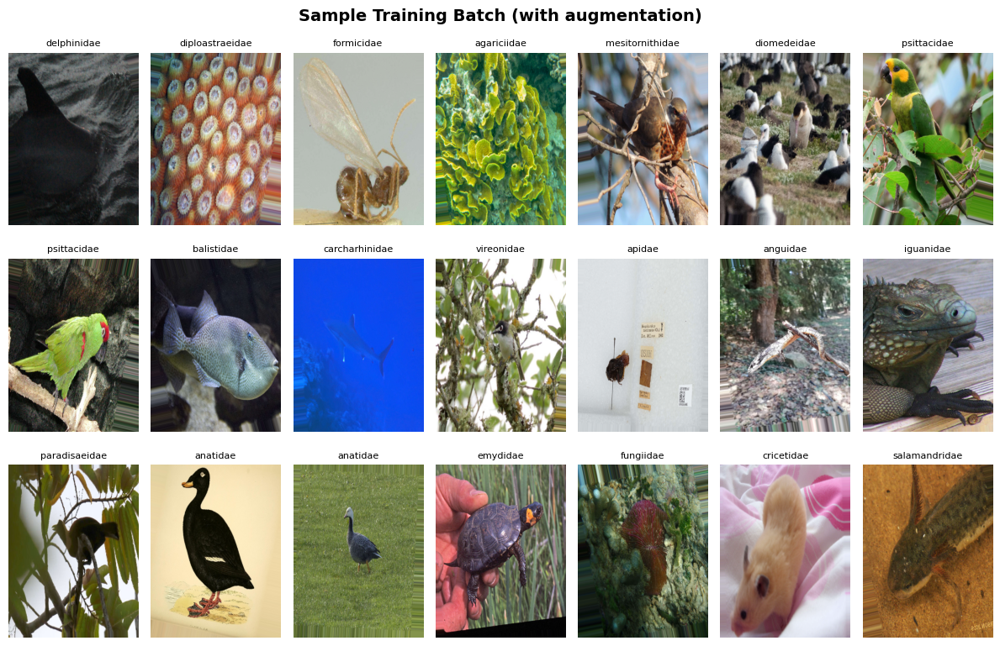

In [77]:
plot_datagen_sample(train_generator)

## Modeling


In [78]:
N_CLASSES = len(train_generator.class_indices)
print(f"Number of classes: {N_CLASSES}")

Number of classes: 202


### Hyperband parameter search

In [ ]:
def build_model(hp):

    # Get the base model set up
    base_model = EfficientNetB4(
        weights='imagenet',
        include_top=False,
        input_shape=(*image_size, 3) 
    )
    # Freeze the base model
    base_model.trainable = False

    with tf.device('/GPU:0'):   # Move the model to gpu
        model = Sequential([
            base_model,
            GlobalAveragePooling2D(),
            BatchNormalization()
        ])

    # Tune the number of hidden layers
    for i in range(1, hp.Int("num_layers", 2, 4)):  # 1, 2 or 3 layers (excluding the final classification layer)
        model.add(
            keras.layers.Dense(
                units=hp.Int("units_" + str(i), min_value=400, max_value=1000, step=200),
                activation="relu")
            )

        # Tune the Dropout
        model.add(keras.layers.Dropout(hp.Float("dropout_" + str(i), 0, 0.5, step=0.1)))

    # Add classification layer
    model.add(keras.layers.Dense(units=N_CLASSES, activation="softmax"))

    # Add optimizer choice
    optimizer_name = hp.Choice("optimizer", ["adam", "adagrad"])

    if optimizer_name == "adam":
        optimizer = Adam(learning_rate=0.001)
    else:
        optimizer = Adagrad(learning_rate=0.01)

    # Compile the model
    model.compile(
        optimizer=optimizer,
        loss='sparse_categorical_crossentropy',
        metrics=["accuracy"]
    )
    
    return model

In [ ]:
# Create the tuner
tuner = kt.Hyperband(
    build_model,
    objective='val_loss',
    max_epochs=10,
    factor=3,
    directory='keras_tuner',
    project_name='b4_test3'
)

In [311]:
tuner.search_space_summary()

Search space summary
Default search space size: 4
num_layers (Int)
{'default': None, 'conditions': [], 'min_value': 2, 'max_value': 4, 'step': 1, 'sampling': 'linear'}
units_1 (Int)
{'default': None, 'conditions': [], 'min_value': 400, 'max_value': 1000, 'step': 200, 'sampling': 'linear'}
dropout_1 (Float)
{'default': 0.0, 'conditions': [], 'min_value': 0.0, 'max_value': 0.5, 'step': 0.1, 'sampling': 'linear'}
optimizer (Choice)
{'default': 'adam', 'conditions': [], 'values': ['adam', 'adagrad'], 'ordered': False}


In [313]:
# Set up callbacks
callbacks = [
    EarlyStopping(
        monitor='val_loss',
        patience=4,
        restore_best_weights=True,
        verbose=1
    ),
    ReduceLROnPlateau(
        monitor='val_loss',
        factor=0.3,
        patience=2,
        min_lr=1e-7,
        verbose=1
    )
]

# Calculate the class weights
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.unique(train_generator.classes),
    y=train_generator.classes
)
class_weight_dict = dict(enumerate(class_weights))

In [ ]:
# Run the tuner
tuner.search(train_generator, epochs=10, batch_size=400, class_weight=class_weight_dict, validation_data=val_generator, callbacks=[callbacks])

Trial 30 Complete [00h 33m 46s]
val_loss: 0.7671439051628113

Best val_loss So Far: 0.6570156812667847
Total elapsed time: 06h 52m 44s


In [ ]:
# Check the best hyperparameters
best_hp=tuner.get_best_hyperparameters()[0]
print(best_hp.values)

{'num_layers': 2, 'units_1': 600, 'dropout_1': 0.4, 'optimizer': 'adagrad', 'units_2': 700, 'dropout_2': 0.0, 'units_3': 400, 'dropout_3': 0.1, 'tuner/epochs': 20, 'tuner/initial_epoch': 0, 'tuner/bracket': 0, 'tuner/round': 0}


So the final **best model** (to add on top of pretrained bone) is:

- One Dense layer with **600 neurons**

- Dropout of **0.4**

- And the optimizer is  **adagrad**

### Train the best model

In [ ]:
# # Generate model with best parameters
# tuned_B4 = build_model(best_hp)

In [79]:
# Get the base model set up
base_model_B4 = EfficientNetB4(
    weights='imagenet',
    include_top=False,
    input_shape=(*image_size, 3) 
)

# Freeze the base model
base_model_B4.trainable = False

In [80]:
# Calculate the class weights
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.unique(train_generator.classes),
    y=train_generator.classes
)
class_weight_dict = dict(enumerate(class_weights))

In [81]:
# Build the classifier
with tf.device('/GPU:0'):   # Move the model to gpu
    tuned_model = Sequential([
        base_model_B4,
        GlobalAveragePooling2D(),
        BatchNormalization(),

        Dense(600),
        Dropout(0.4),
        
        Dense(N_CLASSES, activation='softmax')
    ])

In [82]:
# See the parameter counts
print("Total params:", tuned_model.count_params())
print("Non-trainable params:", sum([tf.size(w).numpy() for w in tuned_model.non_trainable_weights]))
print("Trainable params:", sum([tf.size(w).numpy() for w in tuned_model.trainable_weights]))

Total params: 18878193
Non-trainable params: 17677407
Trainable params: 1200786


In [83]:
# Compile the model
tuned_model.compile(
    optimizer=Adagrad(learning_rate=0.01),
    loss='sparse_categorical_crossentropy',     
    metrics=['accuracy'] 
)

# Set up callbacks
callbacks = [
    EarlyStopping(
        monitor='val_loss',
        patience=3,
        restore_best_weights=True,
        verbose=1
    ),
    ReduceLROnPlateau(
        monitor='val_loss',
        factor=0.1,
        patience=2,
        min_lr=1e-5,
        verbose=1
    )
]

# Fit the model
history_tuned = tuned_model.fit(
    train_generator,
    epochs=20,
    batch_size=400,
    class_weight=class_weight_dict,
    validation_data=val_generator,
    callbacks=callbacks,
    verbose=1
)

Epoch 1/20
244/244 [==============================] - 205s 815ms/step - loss: 2.6964 - accuracy: 0.4198 - val_loss: 1.3120 - val_accuracy: 0.6867 - lr: 0.0100
Epoch 2/20
244/244 [==============================] - 197s 806ms/step - loss: 0.9964 - accuracy: 0.6799 - val_loss: 0.9032 - val_accuracy: 0.7387 - lr: 0.0100
Epoch 3/20
244/244 [==============================] - 197s 806ms/step - loss: 0.6791 - accuracy: 0.7524 - val_loss: 0.8075 - val_accuracy: 0.7723 - lr: 0.0100
Epoch 4/20
244/244 [==============================] - 197s 805ms/step - loss: 0.5250 - accuracy: 0.7976 - val_loss: 0.7543 - val_accuracy: 0.7838 - lr: 0.0100
Epoch 5/20
244/244 [==============================] - 200s 819ms/step - loss: 0.4181 - accuracy: 0.8257 - val_loss: 0.7428 - val_accuracy: 0.7873 - lr: 0.0100
Epoch 6/20
244/244 [==============================] - 198s 810ms/step - loss: 0.3570 - accuracy: 0.8443 - val_loss: 0.7182 - val_accuracy: 0.7965 - lr: 0.0100
Epoch 7/20
244/244 [==========================

In [84]:
plot_model_results(history_tuned, 'loss')

In [85]:
plot_model_results(history_tuned, 'accuracy')

### Fine tuning

In [117]:
# Clone the model
fine_tuned_model = tf.keras.models.clone_model(tuned_model)
fine_tuned_model.set_weights(tuned_model.get_weights())

In [118]:
# Unfreeze last 5 layers of base model
base_model_finetune = fine_tuned_model.get_layer('efficientnetb4')

for layer in base_model_finetune.layers[-5:]:
    print(layer)
    # Keep BatchNormalization frozen
    if not isinstance(layer, tf.keras.layers.BatchNormalization):
        layer.trainable = True

In [119]:
# See the parameter counts
print("Total params:", fine_tuned_model.count_params())
print("Non-trainable params:", sum([tf.size(w).numpy() for w in fine_tuned_model.non_trainable_weights]))
print("Trainable params:", sum([tf.size(w).numpy() for w in fine_tuned_model.trainable_weights]))

Total params: 18878193
Non-trainable params: 16874591
Trainable params: 2003602


In [120]:
# Compile the model
fine_tuned_model.compile(
    optimizer=Adam(learning_rate=1e-7),
    loss='sparse_categorical_crossentropy',     
    metrics=['accuracy'] 
)

# Set up callbacks
callbacks = [
    EarlyStopping(
        monitor='val_accuracy',
        patience=2,
        restore_best_weights=True,
        verbose=1
    )
]

# Fit the model
history_fine_tuned = fine_tuned_model.fit(
    train_generator,
    epochs=10,
    batch_size=400,
    class_weight=class_weight_dict,
    validation_data=val_generator,
    callbacks=callbacks,
    verbose=1
)

Epoch 1/10
244/244 [==============================] - 249s 995ms/step - loss: 0.1544 - accuracy: 0.9238 - val_loss: 0.6566 - val_accuracy: 0.8139
Epoch 2/10
244/244 [==============================] - 242s 993ms/step - loss: 0.1429 - accuracy: 0.9298 - val_loss: 0.6571 - val_accuracy: 0.8162
Epoch 3/10
244/244 [==============================] - 259s 1s/step - loss: 0.1431 - accuracy: 0.9254 - val_loss: 0.6564 - val_accuracy: 0.8162
Epoch 4/10
244/244 [==============================] - 235s 964ms/step - loss: 0.1505 - accuracy: 0.9231 - val_loss: 0.6563 - val_accuracy: 0.8185
Epoch 5/10
244/244 [==============================] - 223s 913ms/step - loss: 0.1507 - accuracy: 0.9239 - val_loss: 0.6573 - val_accuracy: 0.8173
Epoch 6/10
244/244 [==============================] - 272s 1s/step - loss: 0.1444 - accuracy: 0.9279 - val_loss: 0.6561 - val_accuracy: 0.8162
Epoch 6: early stopping


In [121]:
plot_model_results(history_tuned, 'loss', history_fine_tuned)

In [122]:
plot_model_results(history_tuned, 'accuracy', history_fine_tuned)

## Results

In [124]:
test_results = fine_tuned_model.evaluate(test_generator, verbose=1)
print(f"Test Accuracy: {test_results[1]:.4f}")
print(f"Test Loss: {test_results[0]:.4f}")

47/47 [==============================] - 23s 477ms/step - loss: 0.5643 - accuracy: 0.8401
Test Accuracy: 0.8401
Test Loss: 0.5643


In [125]:
# Get predictions
y_pred = fine_tuned_model.predict(test_generator, verbose=1)
y_pred_classes = np.argmax(y_pred, axis=1)

# Get true labels
y_true = test_generator.classes

47/47 [==============================] - 21s 414ms/step


In [126]:
# Calculate metrics
acc = accuracy_score(y_true, y_pred_classes)
f1_micro = f1_score(y_true, y_pred_classes, average='micro')
f1_macro = f1_score(y_true, y_pred_classes, average='macro')
f1_weighted = f1_score(y_true, y_pred_classes, average='weighted')

# Print the metrics
print("--- Model performance ---")
print(f"Accuracy           : {acc:.4f}")
print(f"F1 Score (Micro)   : {f1_micro:.4f}")
print(f"F1 Score (Macro)   : {f1_macro:.4f}")
print(f"F1 Score (Weighted): {f1_weighted:.4f}")

--- Model performance ---
Accuracy           : 0.8401
F1 Score (Micro)   : 0.8401
F1 Score (Macro)   : 0.8288
F1 Score (Weighted): 0.8399


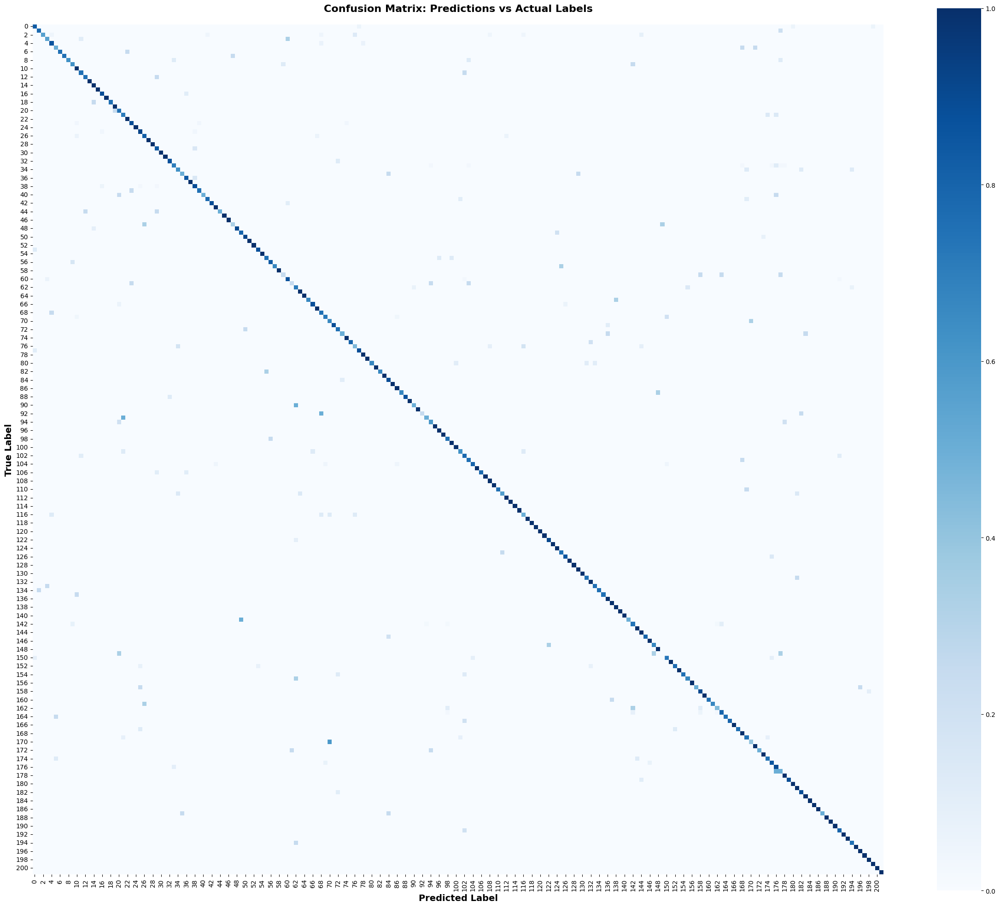

In [128]:
# Check the confusion matrix
cm = confusion_matrix(y_true, y_pred_classes)
plot_confusion_matrix(cm)

In [140]:
# Get the class names for plotting
class_names = sorted(list(metadata['family'].unique()))

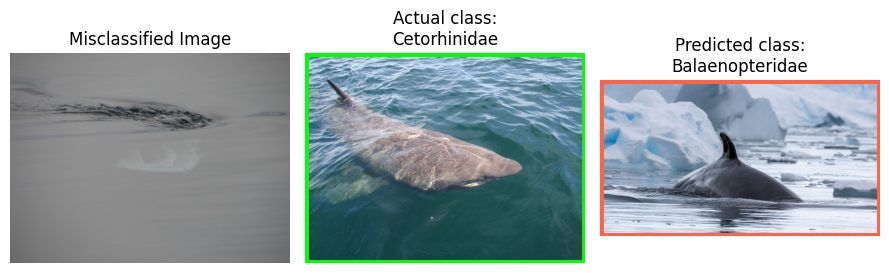

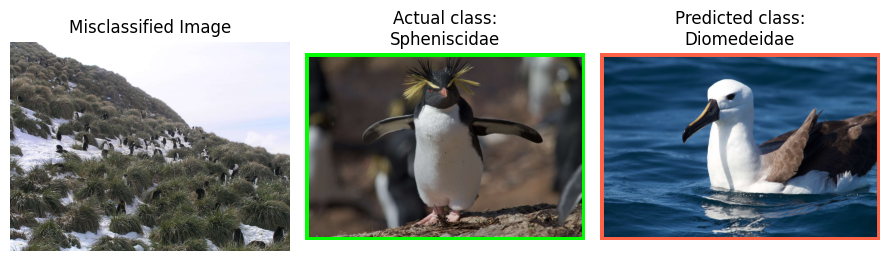

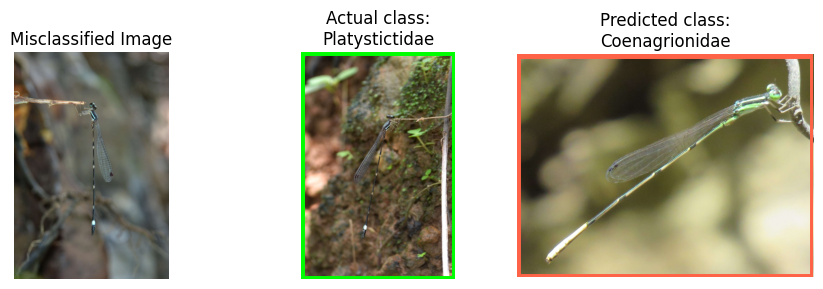

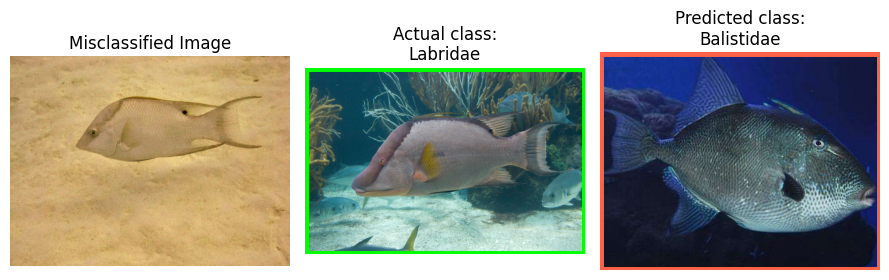

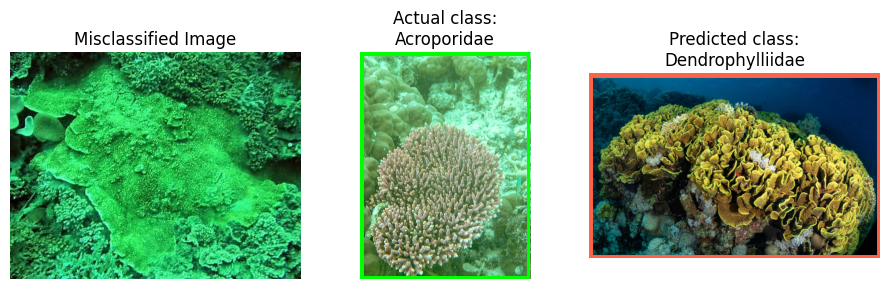

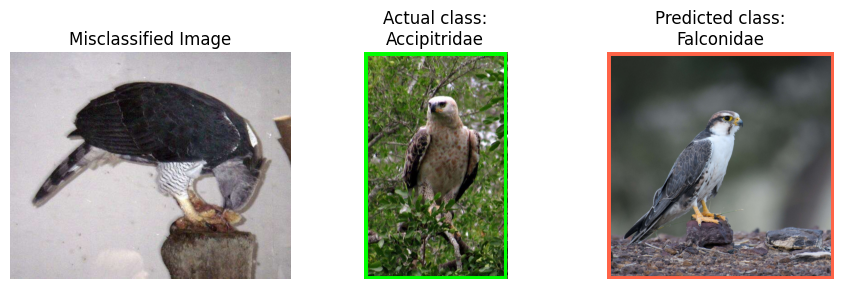

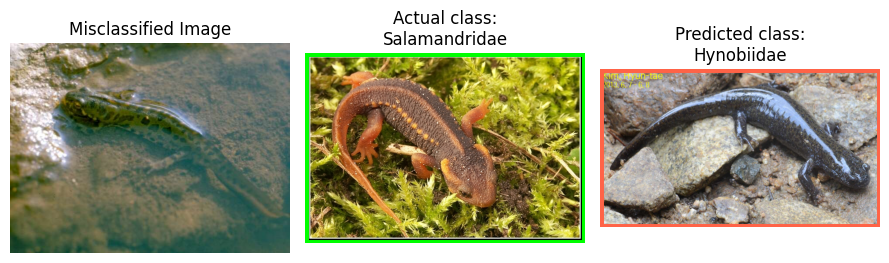

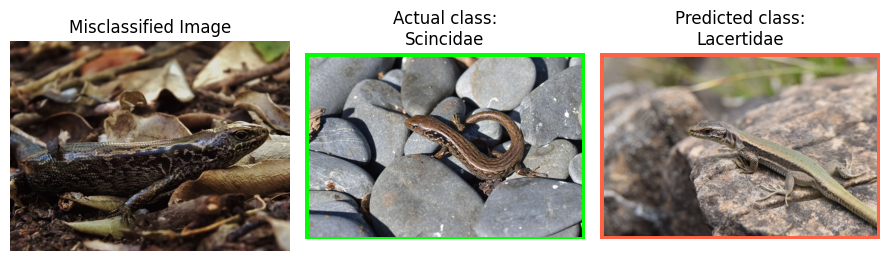

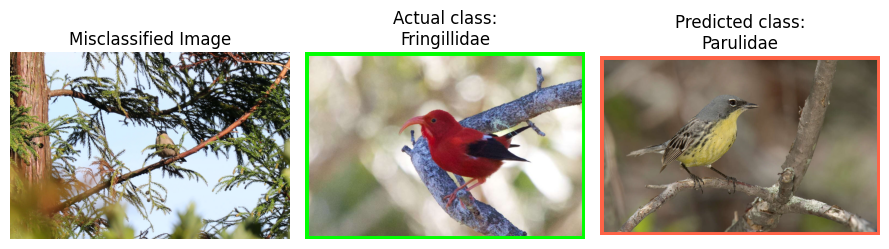

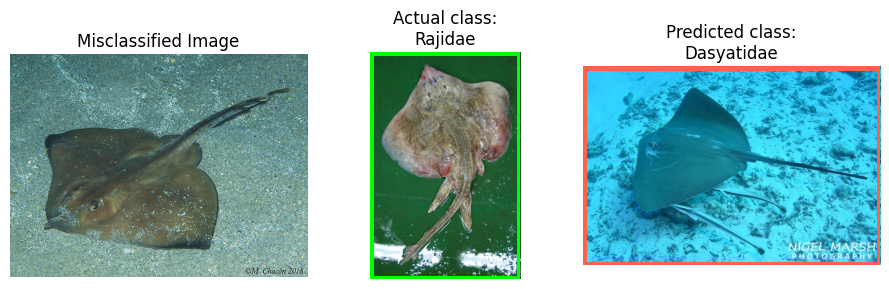

In [141]:
plot_misclassifications(test_generator, y_pred_classes, y_true, class_names, train_df, directory, 10)

## Bonus: Using Metadata to help the model

In [142]:
# Create mapping from family to sparse ID
family_to_id = train_generator.class_indices

# Create mapping from phylum to family
phylum_to_families = {}

for phylum, group in train_df.groupby("phylum"):
    families = group["family"].unique()                
    family_ids = [family_to_id[f] for f in families]   # Convert to sparse IDs
    phylum_to_families[phylum] = family_ids

In [143]:
# Get predictions with metadata
predictions_with_metadata = predict_with_metadata(tuned_model, test_generator, test_df, phylum_to_families)

# Get true labels
y_true = test_generator.classes

1/1 [==============================] - 1s 1s/step


In [144]:
# Calculate metrics
acc = accuracy_score(y_true, predictions_with_metadata)
f1_micro = f1_score(y_true, predictions_with_metadata, average='micro')
f1_macro = f1_score(y_true, predictions_with_metadata, average='macro')
f1_weighted = f1_score(y_true, predictions_with_metadata, average='weighted')


# Print the metrics
print("--- Model performance WITH metadata ---")
print(f"Accuracy           : {acc:.4f}")
print(f"F1 Score (Micro)   : {f1_micro:.4f}")
print(f"F1 Score (Macro)   : {f1_macro:.4f}")
print(f"F1 Score (Weighted): {f1_weighted:.4f}")

--- Model performance WITH metadata ---
Accuracy           : 0.8435
F1 Score (Micro)   : 0.8435
F1 Score (Macro)   : 0.8295
F1 Score (Weighted): 0.8431
